# SpatialMouse - Extract features from multiple kidney samples using pseudo flatfield corrected images + proximity features

## Background

In `SpatialMouse_09a_nuclei_segmentation_features.ipynb` a shading effect from top to bottom of the fluorescent images appeared which prevented an equal detection of vessels in all parts of the tissue.

<br> 
<br>
To solve this I applied the "Pseudo flatfield correction" tool from the "Biovoxxel" suite in Imagej with a blurring radius of 5000 pixels to remove this effect.

<br>

Further, in case of `"37_46_B3"` (Scene-06) an overlapping tissue in the upper part of the image was manually removed.
## Goal

1. Generation of ImageContainer with corrected images of Kidney samples "37_46_C1" and "37_46_B3"
2. Recalculation of feature properties
3. Calculation of feature properties in proximity of nuclei.
4. Identification of endothelial cells and vessel structures using thresholding of CD31 and phalloidin signal.

In [1]:
## The following code ensures that all functions and init files are reloaded before executions.
%load_ext autoreload
%autoreload 2

In [2]:
#%gui qt

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
import pandas as pd
import anndata
import seaborn as sns
from tqdm import tqdm
from glob import glob
import squidpy as sq
import gc
import cv2
from pathlib import Path
from skimage.measure import regionprops_table, regionprops
#import sfaira

## Import the custom library
import os
import sys
module_path = os.path.abspath(os.path.join('/home/hpc/johannes.wirth/projects/DbitX_toolbox/'))
#module_path = os.path.abspath(os.path.join("/lustre/groups/hpc/meier_lab/projects/git/DbitX_toolbox/"))

if module_path not in sys.path:
    sys.path.append(module_path)

import dbitx_funcs as db

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [4]:
from skimage.draw import polygon
from scipy.spatial import Voronoi, voronoi_plot_2d

In [5]:
plt.rcParams['figure.dpi'] = 80
plt.style.use('default')

In [7]:
# data_dir = "/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation"
# img_dir = "/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/images/pseudoffc"

data_dir = "/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/segmentation"
img_dir = "/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc"

# Generate ImageContainer with corrected images

In [11]:
img_files = glob(os.path.join(img_dir, "*"))

scenes = ["01", "06"]
keys = ["37_46_C1", "37_46_B3"]

# create channel dict: The order determines the color in the ImageContainer later!
ch_dict = {
    "c3": "CD31",
    "c2": "phalloidin",
    "c1": "dapi",
    "c4": "bf"
}

In [9]:
img_files

['/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-01_c3ffc5000_stitched_flipped.tif',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-01_c4ffcffc5000_stitched_flipped.tif',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-06_c4ffcffc5000_stitched_flipped_cropped.tif',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-06_c3ffc5000_stitched_flipped_cropped.tif',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-01_c2ffc5000_stitched_flipped.tif',
 '/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_1

In [12]:
imdict = {}
for i, key in enumerate(keys):
    scene = scenes[i]
    imgs = []
    for ch, lab in ch_dict.items():
        img_file = [f for f in img_files if (ch in f and scene in f)][0]
        print(img_file)
        imgs.append(cv2.imread(img_file, 0))
        #image.add_img(img, layer=lab)
    imdict[key] = imgs

/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-01_c3ffc5000_stitched_flipped.tif
/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-01_c2ffc5000_stitched_flipped.tif
/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-01_c1ffc5000_stitched_flipped.tif
/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-01_c4ffcffc5000_stitched_flipped.tif
/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Scene-06_c3ffc5000_stitched_flipped_cropped.tif
/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/images/pseudoffc/37_46_firstimaging_13x13_10%_2021_12_09__10_25_51-Sce

In [13]:
containers = {key: sq.im.ImageContainer(np.array(imgs)) for key, imgs in imdict.items()}

### Change channel names

In [16]:
for image in containers.values():
    # extract dataarray
    ar = image['image'] 
    # change channel names
    ar['channels'] = list(ch_dict.values())
    
    # add data array to container
    image.add_img(ar, layer='image')

In [18]:
containers['37_46_C1']['image']['channels']

<xarray.DataArray 'channels' (channels: 4)>
array(['CD31', 'phalloidin', 'dapi', 'bf'], dtype=object)
Coordinates:
  * channels  (channels) object 'CD31' 'phalloidin' 'dapi' 'bf'

In [21]:
containers

{'37_46_C1': ImageContainer[shape=(20296, 20296), layers=['image']],
 '37_46_B3': ImageContainer[shape=(20296, 20296), layers=['image']]}

37_46_C1
37_46_B3


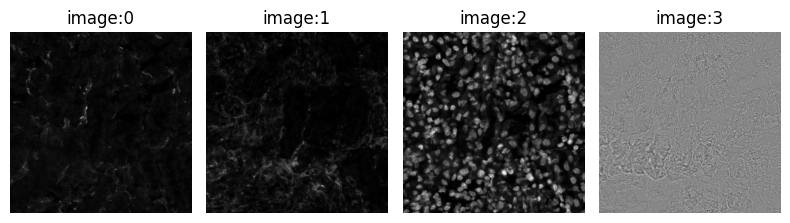

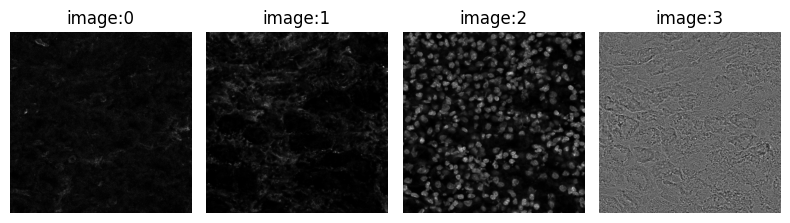

In [25]:
for key, image in containers.items():
    print(key)
    crop = image.crop_center(10000, 10000, radius=500)
    crop.show(channelwise=True, cmap="gray")

## Transfer segmented image from old image container into new one

In [27]:
key = "37_46_C1"

for key in keys():
    container_dir = os.path.join(data_dir, "imagecontainers")
    store = os.path.join(container_dir, key)

In [28]:
store

'/home/hpc/johannes.wirth/data/experiments/SpatialMouse/analysis/segmentation/imagecontainers/37_46_C1'

In [29]:
oldcontainers = {key: sq.im.ImageContainer.load(os.path.join(data_dir, "imagecontainers", key)) for key in keys}

In [30]:
oldcontainers

{'37_46_C1': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']],
 '37_46_B3': ImageContainer[shape=(20296, 20296), layers=['CD31', 'bf', 'dapi', 'phalloidin', 'segmented']]}

In [31]:
for key, image in containers.items():
    image.add_img(oldcontainers[key]["segmented"], layer="segmented")
    image["segmented"].attrs["segmentation"] = True

In [32]:
containers[key]

ImageContainer[shape=(20296, 20296), layers=['image', 'segmented']]

37_46_C1
37_46_B3


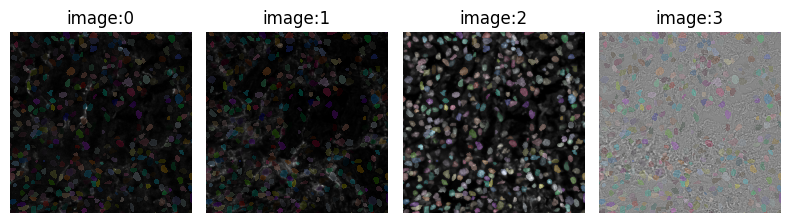

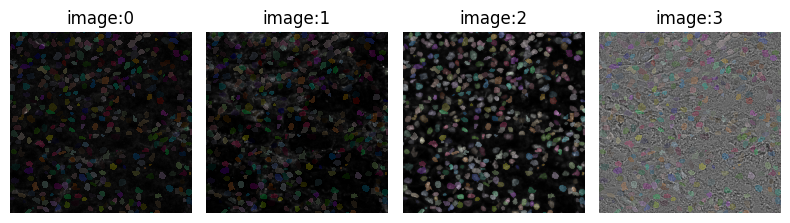

In [36]:
for key, image in containers.items():
    print(key)
    crop = image.crop_center(10000, 10000, radius=500)
    crop.show(layer='image', channelwise=True, cmap="gray", segmentation_layer="segmented", segmentation_alpha=0.2)

37_46_C1
37_46_B3


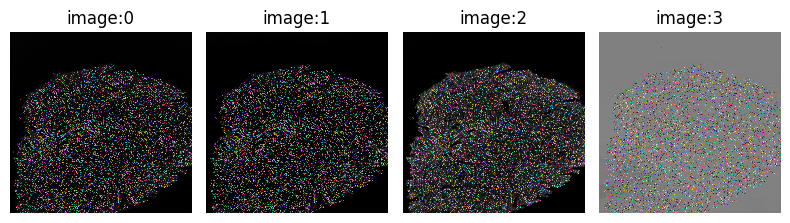

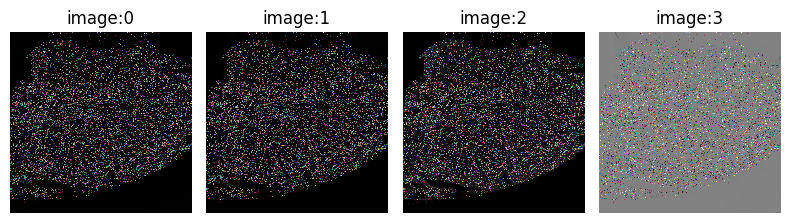

In [38]:
for key, image in containers.items():
    print(key)
    image.show(layer='image', channelwise=True, cmap="gray", segmentation_layer="segmented", segmentation_alpha=0.8)

# Calculate regionprops

In [39]:
binary_cats = ("label", "area", "perimeter", "eccentricity", "centroid", "bbox")
intensity_cats = ("intensity_mean", "intensity_max", "intensity_min", "image_intensity")

In [41]:
indices = list(containers.keys())

regprops = {}
for i, idx in enumerate(indices):
    print("Processing {} ({}/{})".format(idx, i+1, len(indices)))
    
    props = {}
    props["intensity"] = {}
    
    # get image container
    image = containers[idx]
    
    # get label image
    label_img = np.array(image['segmented'].squeeze())

    # calculate binary region props and store them in dictionary
    print("\tCalculating binary regionprops...")
    bin_props = regionprops_table(label_image=label_img, properties=binary_cats)
    props["binary"] = pd.DataFrame(bin_props)

    # extract number of channels
    #nchannels = image['image'].to_numpy().shape[-1]
    channels = image['image']['channels'].to_numpy()
    
    # get intensity layers
    #int_layers = [elem for elem in list(image) if not elem == "segmented"]

    #for label in int_layers:
    for ch in channels:
        print("\tCalculating intensity regionprops for channel {}...".format(ch))
        # fetch intensity image
        intensity_img = image['image'].sel(channels=ch).to_numpy().squeeze()
        #intensity_img = np.array(image['image'].to_numpy().squeeze())

        # calculate intensity dependent regionprops for this channel
        int_props = regionprops_table(label_image=label_img, intensity_image=intensity_img,
                                      properties=intensity_cats)
        props["intensity"][ch] = pd.DataFrame(int_props)
        
    regprops[idx] = props

Processing 37_46_C1 (1/2)
	Calculating binary regionprops...
	Calculating intensity regionprops for channel CD31...
	Calculating intensity regionprops for channel phalloidin...
	Calculating intensity regionprops for channel dapi...
	Calculating intensity regionprops for channel bf...
Processing 37_46_B3 (2/2)
	Calculating binary regionprops...
	Calculating intensity regionprops for channel CD31...
	Calculating intensity regionprops for channel phalloidin...
	Calculating intensity regionprops for channel dapi...
	Calculating intensity regionprops for channel bf...


# Calculate proximity signal

In [42]:
def dilate_feature(img, radius):
    kernel = np.ones((radius,radius),np.uint8)
    
    dilated = cv2.dilate(img.astype('uint8'), kernel=kernel)
    return dilated

def get_proximity_signal(featprops, label_img, intensity_img, proxradius=40, return_all=False):
    l=int(featprops['label'])
    r=int(featprops['centroid-0'])
    c=int(featprops['centroid-1'])
    radius=proxradius * 2

    # get edges 
    rmin = r-radius
    rmax = r+radius
    cmin = c-radius
    cmax = c+radius

    # assure that the min values are not negative
    if rmin < 0:
        rmin = 0
    if cmin < 0:
        cmin = 0

    detail = label_img[rmin:rmax, cmin:cmax]
    signal_img = intensity_img[rmin:rmax, cmin:cmax]
        
    # extract mask with correct label
    detail = detail == l

    # determine the radius from the size of the nucleus
    #radius = int(feat['equivalent_diameter_area'])

    # dilate the binary mask
    dilated = dilate_feature(detail, radius=proxradius)
        
    # get binary mask of surrounding
    proximity = (dilated & ~detail).astype(bool)
    
    if return_all:
        # return (1) signal in proximity, (2) mask of proximity region and (3) image of the whole signal
        return signal_img[proximity], proximity, signal_img
    else:
        # return only the signal in the proximity
        return signal_img[proximity]

## Extract proximity signal

In [43]:
#key = "37_46_C3"
channels_to_measure = ["phalloidin", "CD31"]
#channels_to_measure = [0, 1]

proxradius = 40

for key in sorted(regprops.keys()):
    print("Processing {}:".format(key))
    # select binary properties for this section
    binprops = regprops[key]['binary']
    label_img = containers[key]['segmented'].squeeze().to_numpy()

    # get the channels for this key and select the ones to measure
    allchannels = list(regprops[key]['intensity'].keys())
    channels = [c for c in allchannels if c in channels_to_measure]
    
    if len(channels) == 0:
        print("None of the channels {} of this key are in the list `channels_to_measure` {}".format(allchannels, channels_to_measure))

    #ch = "CD31"
    for ch in channels:
        print("\tChannel: {}".format(ch))
        intprops = regprops[key]['intensity'][ch]
        intensity_img = containers[key]['image'].sel(channels=ch).squeeze().to_numpy()

        assert len(intprops) == len(binprops), \
            "Intensity properties {} and binary properties {} do not have the same length.".format(len(intprops), len(binprops))

        # iterate through features and calculate signal inside proxradius
        signals = []
        proxmasks = []
        signal_imgs = []
        for i, featprops in binprops.iterrows():
            signal, proxmask, signal_img = get_proximity_signal(featprops=featprops,
                                                                     label_img=label_img,
                                                                     intensity_img=intensity_img, 
                                                                     proxradius=proxradius,
                                                                     return_all=True)
            signals.append(signal)
            proxmasks.append(proxmask)
            signal_imgs.append(signal_img)
            
        #signals.append(signal)

        # calculate mean, max, min of signals and add to intensityprops
        # intprops['mean_proximity'] = [np.average(signal) for signal in signals]
        # intprops['sum_proximity'] = [np.sum(signal) for signal in signals]
        # intprops['area_proximity'] = [len(signal) for signal in signals]
        # intprops['max_proximity'] = [np.max(signal) for signal in signals]
        # intprops['min_proximity'] = [np.min(signal) for signal in signals]
        intprops['proximity_signal'] = signals
        intprops['proximity_mask'] = proxmasks
        intprops['signal_image'] = signal_imgs

Processing 37_46_B3:
	Channel: CD31
	Channel: phalloidin
Processing 37_46_C1:
	Channel: CD31
	Channel: phalloidin


## Calculate parameters from proximity signals

In [44]:
signal_label = "proximity_signal"
out = {}

for key in sorted(regprops.keys()):
    print("Processing {}".format(key))
    
    #intprops = regprops[key]['intensity']
    channels = list(regprops[key]['intensity'].keys())
    
    for ch in channels:
        intprops = regprops[key]['intensity'][ch]
        signal_labels = intprops.columns
        if signal_label in signal_labels:
            print("\t{}: Calculating...".format(ch))
            signals = intprops[signal_label].values
            
            # calculate statistics
            intprops['proximity_mean'] = np.array([np.average(signal) for signal in signals])
            intprops['proximity_median'] = np.array([np.median(signal) for signal in signals])
            intprops['proximity_sum'] = np.array([np.sum(signal) for signal in signals])
            intprops['proximity_area'] = np.array([len(signal) for signal in signals])
            # problem with the calculation of max values - gives negative values in some cases which could not be explained!
            intprops['proximity_max'] = np.array([np.max(signal) for signal in signals] )
            intprops['proximity_min'] = np.array([np.min(signal) for signal in signals])
        
            out[ch] = intprops
        else:
            print("\t{}: Label `{}` not found in column headers.".format(ch, signal_label))

Processing 37_46_B3
	CD31: Calculating...
	phalloidin: Calculating...
	dapi: Label `proximity_signal` not found in column headers.
	bf: Label `proximity_signal` not found in column headers.
Processing 37_46_C1
	CD31: Calculating...
	phalloidin: Calculating...
	dapi: Label `proximity_signal` not found in column headers.
	bf: Label `proximity_signal` not found in column headers.


## Plot scatterplot of signals per nucleus

In [45]:
keys = [elem for elem in regprops.keys() if elem.startswith("37_46")]

In [47]:
# ch_label_dict = {
#     0: "CD31",
#     1: "Phalloidin",
#     2: "DAPI",
#     3: "BF"
# }

normalize = True

signaldata = {}
for key in keys:
    d = {}
    d["label"] = regprops[key]['binary']['label']
    
    channels = list(regprops[key]['intensity'].keys())
    for ch in channels:
        for cat in ['mean', 'median', 'max']:
            label = "proximity_{}".format(cat)
            if label in regprops[key]['intensity'][ch].columns:
                vals = regprops[key]['intensity'][ch][[label]]
                if normalize:
                    vals = vals.apply(lambda x: (x - x.min()) / (x.max() - x.min()))
                #d["{}_{}".format(ch_label_dict[ch], cat)] = vals[label].values
                d["{}_{}".format(ch, cat)] = vals[label].values
        
    signaldata[key] = pd.DataFrame(d)

signaldata = pd.concat(signaldata)
signaldata = signaldata.reset_index(level=0).rename(columns={'level_0': 'id'}).sort_values(['id', 'label'])

In [48]:
signaldata

,id,label,CD31_mean,CD31_median,CD31_max,phalloidin_mean,phalloidin_median,phalloidin_max
0,37_46_B3,1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,37_46_B3,2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,37_46_B3,3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,37_46_B3,4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,37_46_B3,5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...
101448,37_46_C1,101449,0.080675,0.104651,0.088235,0.039666,0.017391,0.166008
101449,37_46_C1,101450,0.116656,0.139535,0.138655,0.049611,0.026087,0.217391
101450,37_46_C1,101451,0.045460,0.058140,0.092437,0.010288,0.008696,0.043478
101451,37_46_C1,101452,0.247416,0.267442,0.344538,0.167146,0.121739,0.407115


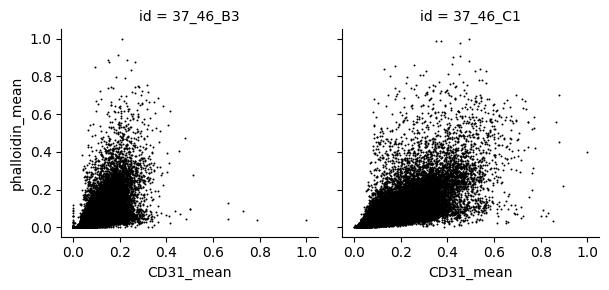

In [49]:
g = sns.FacetGrid(signaldata, col="id", col_wrap=3)
g.map(sns.scatterplot, "CD31_mean", "phalloidin_mean", s=2, color='k', linewidth=0)

plt.show()

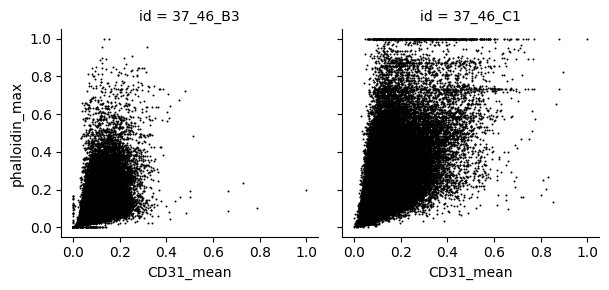

In [50]:
g = sns.FacetGrid(signaldata, col="id", col_wrap=3)
g.map(sns.scatterplot, "CD31_mean", "phalloidin_max", s=2, color='k', linewidth=0)

plt.show()

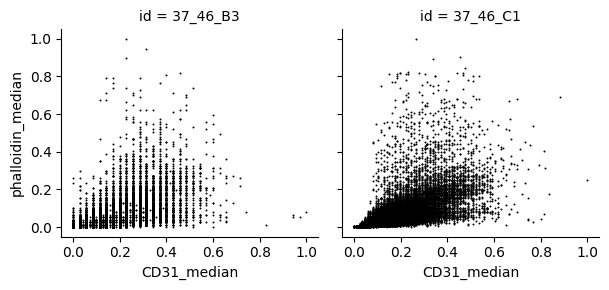

In [51]:
g = sns.FacetGrid(signaldata, col="id", col_wrap=3)
g.map(sns.scatterplot, "CD31_median", "phalloidin_median", s=2, color='k', linewidth=0)

plt.show()

## Check out most promising clusters

Let's start with `37_46_C1`

In [33]:
import random

In [58]:
# key = "37_46_C1"
# CD31_thresh = 0.35
# phal_thresh = 0.4

thresholds = {
    "37_46_B3": (0.3, 0.38), # (CD31_threshold/phalloidin_threshold)
    "37_46_C1": (0.35, 0.4)
}

datas = {}
for key in thresholds.keys():
    # select data
    image = containers[key]
    data = signaldata.query('id == "{}"'.format(key)).copy()

    data["CD31_status"] = ["+" if val >= thresholds[key][0] else "-" for val in data["CD31_mean"]]
    data["phalloidin_status"] = ["+" if val >= thresholds[key][1] else "-" for val in data["phalloidin_mean"]]
    data["quadrant"] = [a + b for a,b in zip(data["CD31_status"], data["phalloidin_status"])]
    datas[key] = data

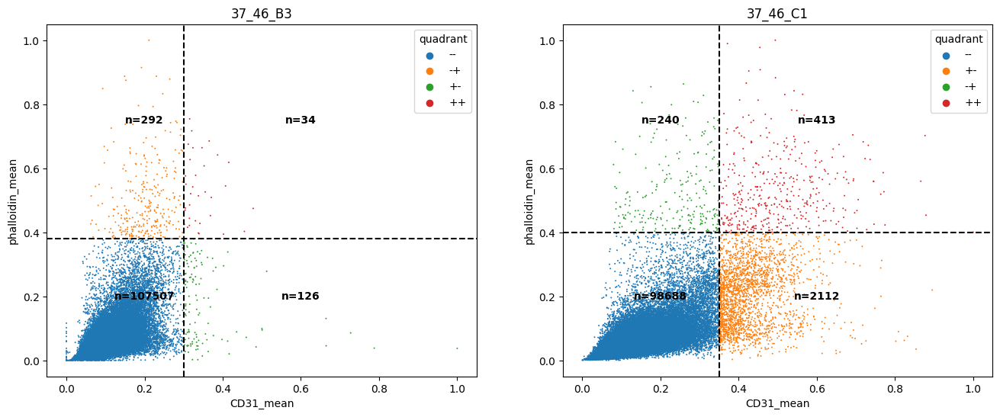

In [67]:
ncols = len(datas)
nrows = 1

fig, axs = plt.subplots(nrows, ncols, figsize=(8*ncols, 6*nrows))

for i, (key, data) in enumerate(datas.items()):
    #sns.scatterplot(data=data, x="CD31_norm", y="Phalloidin_norm", s=2, color='k', linewidth=0)
    sns.scatterplot(data=data, x="CD31_mean", y="phalloidin_mean", hue="quadrant",
                    s=2, color='r', linewidth=0, ax=axs[i])

    axs[i].axvline(thresholds[key][0], linestyle='--', c='k')
    axs[i].axhline(thresholds[key][1], linestyle='--', c='k')


    cats = ['--', '-+', '++', '+-']
    anncoords = [(0.2,0.2), (0.2,0.75), (0.6,0.75), (0.6,0.2)]
    for a, cat in enumerate(cats):
        n = len(data.query('quadrant == "{}"'.format(cat)))
        axs[i].annotate("n={}".format(n), anncoords[a], fontweight='bold',
                     horizontalalignment='center', verticalalignment='center')
        
    axs[i].set_title(key)

plt.savefig("figures/segmentation/scatter_nuclei_phal_CD31_Kidney.pdf")
plt.show()

## Plot for each quadrant example images

Best would be to have an overlay of phalloidin, CD31 and DAPI

## Plot 5 example images per category for notebook

In [69]:
import random

37_46_C1
Category: ++


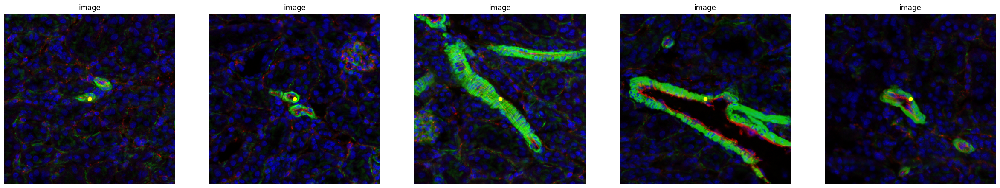

Category: +-


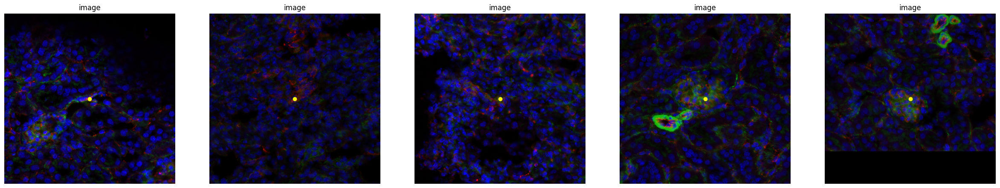

Category: -+


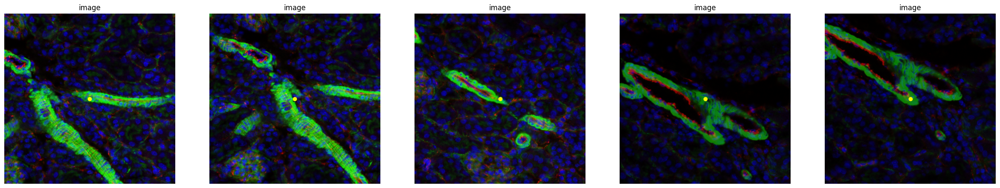

Category: --


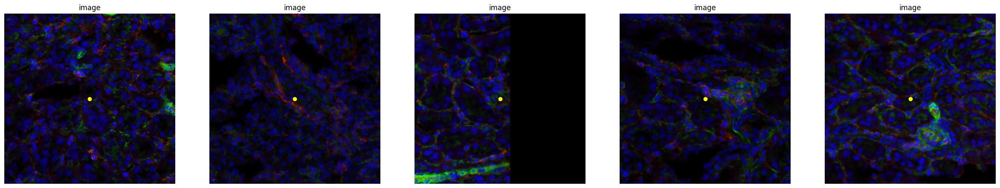

37_46_B3
Category: ++


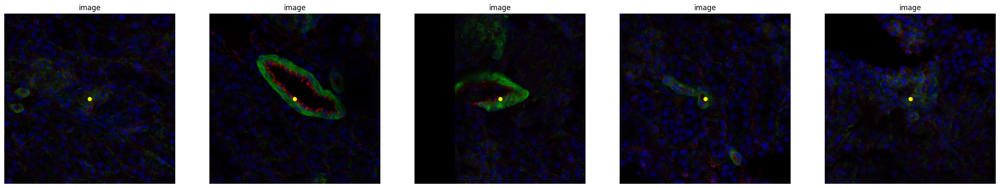

Category: +-


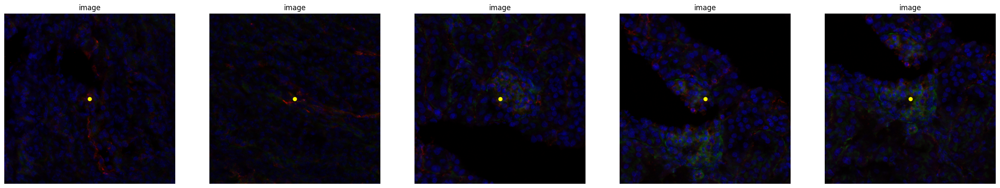

Category: -+


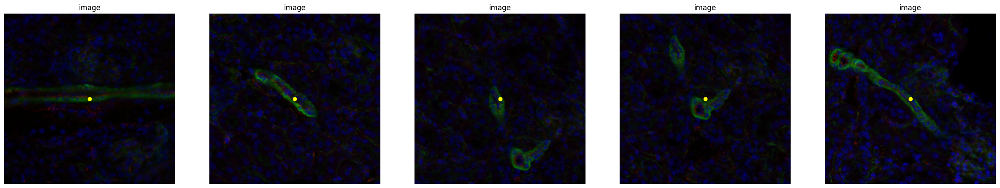

Category: --


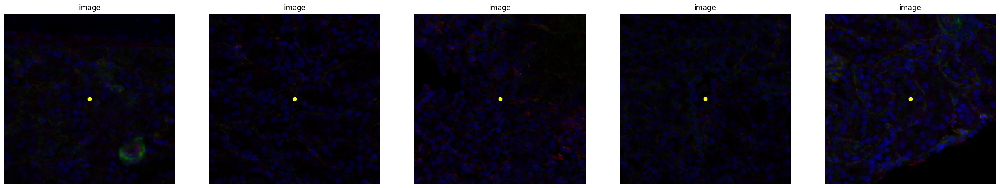

In [77]:
# parameters
n = 5
max_cols = 5
radius = 500

for key, image in containers.items():
    print(key)
    data = datas[key]
    for cat in sorted(data['quadrant'].unique()):
        print("Category: {}".format(cat))
        # select one quadrant
        selected = data.query('quadrant == "{}"'.format(cat))

        # get properties
        intprops = regprops[key]['intensity']
        binprops = regprops[key]['binary']

        # select sample
        random.seed(0)
        idx_sample = random.sample(range(1, len(selected)), n)
        label_sample = selected.iloc[idx_sample, :]['label'].values

        # select sampled labels
        feats = binprops.loc[binprops['label'].isin(label_sample),:]

        ## Plotting
        n_plots, nrows, ncols = db.tl.get_nrows_maxcols(label_sample, max_cols=max_cols)
        fig, axs = plt.subplots(nrows, ncols, figsize=(6*ncols, 6*nrows))

        axs = axs.ravel()

        for r, (i, feat) in enumerate(feats.iterrows()):
            rr = int(feat['centroid-0'])
            cc = int(feat['centroid-1'])

            crop = image.crop_center(rr, cc, radius=radius)
            crop.show(layer='image', channel=[0,1,2], ax=axs[r])

            axs[r].scatter(radius, radius, color='yellow')
        plt.show()

## Save 50 images per category for examination

In [114]:
# parameters
n = 50
max_cols = 5
radius = 500

for key, image in containers.items():
    print("Processing {}".format(key))
    for cat in data['quadrant'].unique():
        print("\tCategory: {}".format(cat))
        # select one quadrant
        data = datas[key]
        selected = data.query('quadrant == "{}"'.format(cat))

        # get properties
        intprops = regprops[key]['intensity']
        binprops = regprops[key]['binary']

        # choose random sample
        if n > len(selected):
            nn = len(selected)
        else:
            nn = n
        
        print("\t\tSelect {} samples...".format(nn))
        random.seed(0)
        idx_sample = random.sample(range(0, len(selected)), nn)
        label_sample = selected.iloc[idx_sample, :]['label'].values

        # select sampled labels
        feats = binprops.loc[binprops['label'].isin(label_sample),:]

        ## Plotting
        n_plots, nrows, ncols = db.tl.get_nrows_maxcols(label_sample, max_cols=max_cols)
        fig, axs = plt.subplots(nrows, ncols, figsize=(6*ncols, 6*nrows))

        axs = axs.ravel()

        for r, (i, feat) in enumerate(feats.iterrows()):
            rr = int(feat['centroid-0'])
            cc = int(feat['centroid-1'])

            crop = image.crop_center(rr, cc, radius=radius)
            crop.show(layer='image', channel=[0,1,2], ax=axs[r])

            axs[r].scatter(radius, radius, color='yellow')

        savefile = "figures/segmentation/vessel_categorization_{}_{}.pdf".format(key, cat)
        plt.savefig(savefile)
        print("Plot saved to {}".format(savefile))
        plt.close()

Processing 37_46_C1
	Category: --
		Select 50 samples...
Plot saved to figures/segmentation/vessel_categorization_37_46_C1_--.pdf
	Category: +-
		Select 50 samples...
Plot saved to figures/segmentation/vessel_categorization_37_46_C1_+-.pdf
	Category: -+
		Select 50 samples...
Plot saved to figures/segmentation/vessel_categorization_37_46_C1_-+.pdf
	Category: ++
		Select 50 samples...
Plot saved to figures/segmentation/vessel_categorization_37_46_C1_++.pdf
Processing 37_46_B3
	Category: --
		Select 50 samples...
Plot saved to figures/segmentation/vessel_categorization_37_46_B3_--.pdf
	Category: +-
		Select 50 samples...
Plot saved to figures/segmentation/vessel_categorization_37_46_B3_+-.pdf
	Category: -+
		Select 50 samples...
Plot saved to figures/segmentation/vessel_categorization_37_46_B3_-+.pdf
	Category: ++
		Select 34 samples...
Plot saved to figures/segmentation/vessel_categorization_37_46_B3_++.pdf


## Result until here

Using the current threshold all 50 sampled nuclei were correclty recognized as being in a vessel! We'll continue to use these settings.


## Show all selected nuclei as points on image

In [86]:
binprops

,label,area,perimeter,eccentricity,centroid-0,centroid-1,bbox-0,bbox-1,bbox-2,bbox-3
0,1,149,58.970563,0.960347,2.516779,3358.771812,0,3345,7,3372
1,2,517,87.597980,0.821926,9.251451,3782.177950,0,3766,21,3799
2,3,64,29.071068,0.767469,2.656250,3837.250000,0,3832,7,3843
3,4,316,70.769553,0.841952,8.344937,4172.702532,0,4161,19,4186
4,5,209,56.041631,0.731441,5.559809,4501.454545,0,4492,14,4512
...,...,...,...,...,...,...,...,...,...,...
107954,107955,624,103.597980,0.871686,19280.642628,609.650641,19261,600,19300,621
107955,107956,175,47.455844,0.511804,19314.377143,608.022857,19308,600,19323,616
107956,107957,142,41.798990,0.456058,19335.197183,558.718310,19329,553,19343,566
107957,107958,477,92.669048,0.891039,19375.968553,566.750524,19366,550,19387,585


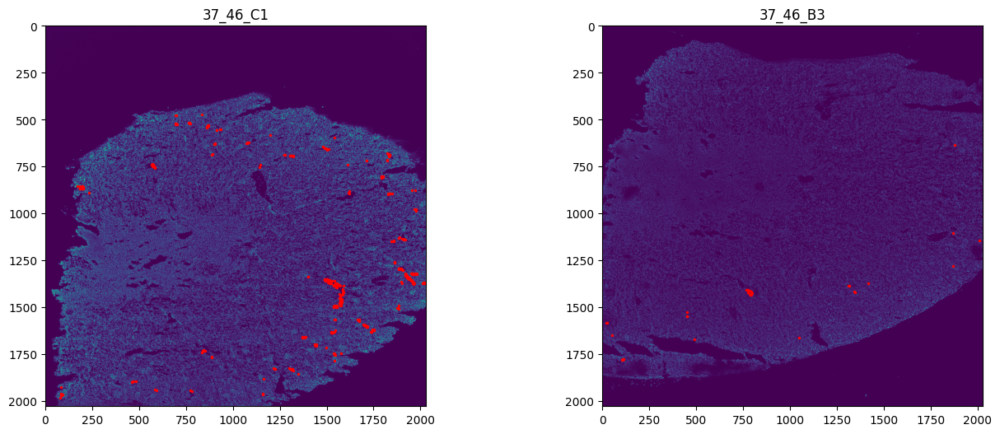

In [90]:
cat = "++"

fig, axs = plt.subplots(1, 2, figsize=(8*2, 6))

for i, (key, image) in enumerate(containers.items()):
    
    data = datas[key]
    selected = data.query('quadrant == "{}"'.format(cat))
    labels_selected = selected['label'].values

    # select sampled labels
    binprops = regprops[key]['binary']
    feats = binprops.loc[binprops['label'].isin(labels_selected),:]

    # plotting of image and nuclei as points
    #channels = list(image)
    x = feats['centroid-1']
    y = feats['centroid-0']
    sf = 0.1

    img = image['image'].sel(channels='dapi').to_numpy().squeeze()

    if sf < 1:
            img = db.im.resize_image(img, sf)
    axs[i].imshow(img)
    axs[i].scatter(x*sf, y*sf, color='r', s=2)
    axs[i].set_title(key)

plt.show()

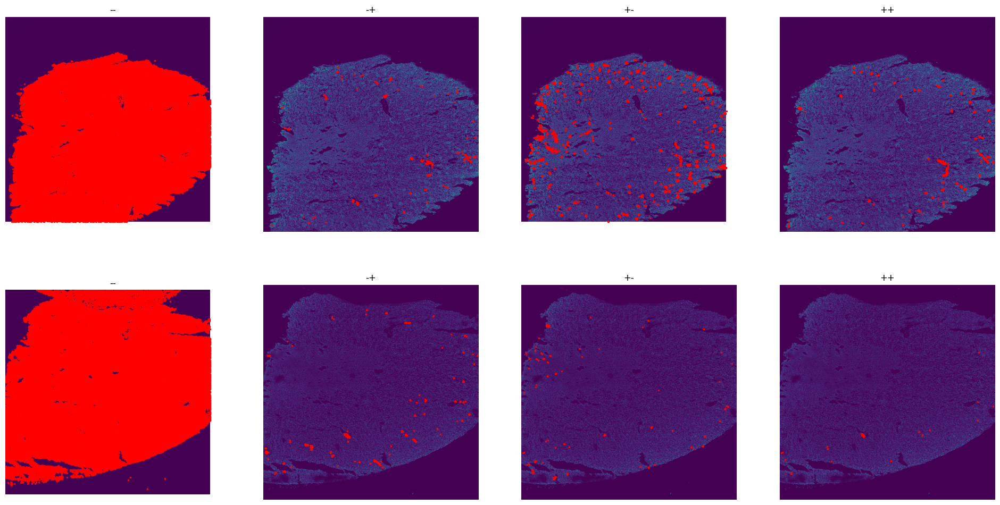

In [94]:
cats = list(data['quadrant'].unique())

nrows = 2
ncols = len(cats)

fig, axs = plt.subplots(nrows, ncols, figsize=(6*ncols, 6*nrows))

for r, (key, image) in enumerate(containers.items()):
    for i, cat in enumerate(cats):
        
        data = datas[key]
        selected = data.query('quadrant == "{}"'.format(cat))
        labels_selected = selected['label'].values

        # select sampled labels
        binprops = regprops[key]['binary']
        feats = binprops.loc[binprops['label'].isin(labels_selected),:]

        # plotting of image and nuclei as points
        #channels = list(image)
        x = feats['centroid-1']
        y = feats['centroid-0']
        sf = 0.1

        img = image['image'].sel(channels='dapi').to_numpy().squeeze()

        if sf < 1:
                img = db.im.resize_image(img, sf)
        axs[r, i].imshow(img)
        axs[r, i].scatter(x*sf, y*sf, color='r', s=2)
        axs[r, i].set_title(cat)
        axs[r, i].axis('off')

#plt.savefig("figures/segmentation/quadrants_nucs_example_{}.png".format(key), dpi=600, bbox_inches='tight')
plt.show()

# Select vessels

## Note down which nuclei belong to a vessel in the binary props

In [101]:
# select conditions that will count as vessel
vessel_cats = ["-+", "++"]

for key in regprops.keys():
    # extract binprops
    binprops = regprops[key]['binary']
    
    # get data
    data = datas[key]

    # select correct labels and add true/false to binprops
    selected = data.loc[data["quadrant"].isin(vessel_cats), :]
    labels_selected = selected['label'].values
    binprops['vessel'] = binprops['label'].isin(labels_selected)

## Plot selected vessels

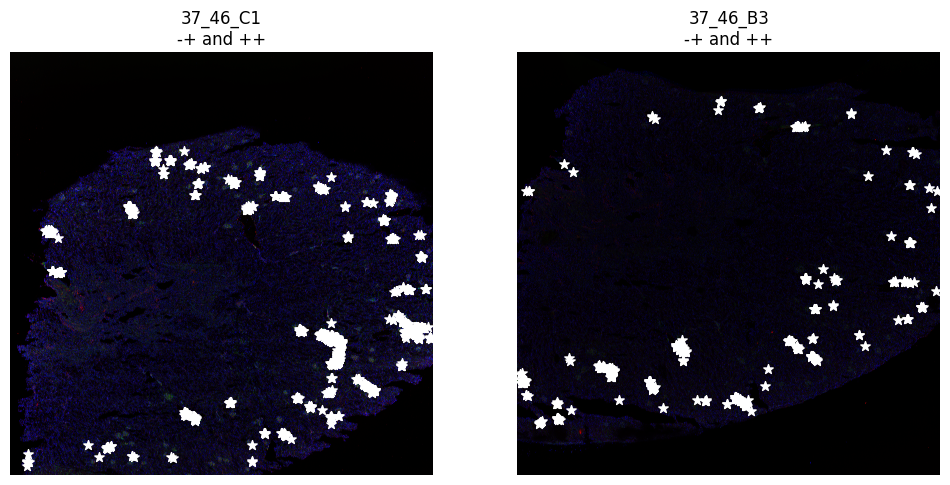

In [127]:
keys = list(regprops.keys())

nrows = 1
ncols = len(keys)

fig, axs = plt.subplots(nrows, ncols, figsize=(6*ncols, 6*nrows))

for c, key in enumerate(keys):
    # extract image
    image = containers[key]
    
    # extract binprops
    binprops = regprops[key]['binary']
    
    feats = binprops.loc[binprops['vessel']]

    # plotting of image and nuclei as points
    #channels = list(image)
    x = feats['centroid-1']
    y = feats['centroid-0']

    #img = image['image'].sel(channels='dapi').to_numpy().squeeze()

    image.show(layer='image', channel=[0,1,2], ax=axs[c])
    axs[c].scatter(x, y, color='white', s=50, marker='*')

    axs[c].set_title("{}\n{}".format(key, " and ".join(vessel_cats)))

plt.savefig("figures/segmentation/vessel_nucs_example_kidneys_stars.pdf", bbox_inches='tight')
plt.show()

# Save updated regionprops

In [103]:
db.im.save_regprops(regprops, 
                    #savedir="/lustre/groups/hpc/meier_lab/projects/SpatialMouse/analysis/segmentation/features/proximity",
                    savedir=os.path.join(data_dir, "features", "proximity"),
                    save_images=False)

Saving 37_46_C1...
	CD31
	phalloidin
	dapi
	bf
Saving 37_46_B3...
	CD31
	phalloidin
	dapi
	bf


# Reload regionprops

In [106]:
feature_files = glob(os.path.join(data_dir, "features", "proximity", "*.csv"))

In [107]:
loaded = db.im.load_regprops(feature_files)

In [108]:
loaded[key]['binary']

,label,area,perimeter,eccentricity,centroid-0,centroid-1,bbox-0,bbox-1,bbox-2,bbox-3,vessel
0,1,149,58.970563,0.960347,2.516779,3358.771812,0,3345,7,3372,False
1,2,517,87.597980,0.821926,9.251451,3782.177950,0,3766,21,3799,False
2,3,64,29.071068,0.767469,2.656250,3837.250000,0,3832,7,3843,False
3,4,316,70.769553,0.841952,8.344937,4172.702532,0,4161,19,4186,False
4,5,209,56.041631,0.731441,5.559809,4501.454545,0,4492,14,4512,False
...,...,...,...,...,...,...,...,...,...,...,...
107954,107955,624,103.597980,0.871686,19280.642628,609.650641,19261,600,19300,621,False
107955,107956,175,47.455844,0.511804,19314.377143,608.022857,19308,600,19323,616,False
107956,107957,142,41.798990,0.456058,19335.197183,558.718310,19329,553,19343,566,False
107957,107958,477,92.669048,0.891039,19375.968553,566.750524,19366,550,19387,585,False


# Plotting for figures

### Plot example images of proximity measurement

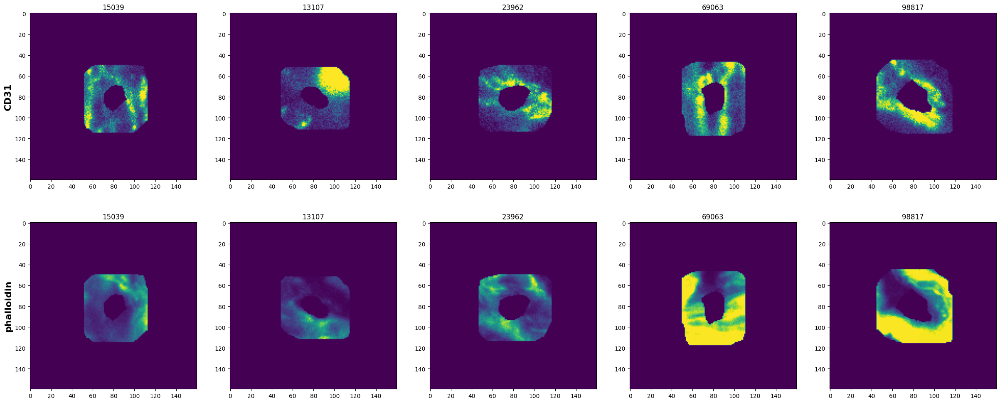

In [195]:
key = '37_46_C1'
i = 0
channels = ["CD31", "phalloidin"]
sortby = "CD31"
topn = 5

nrows = len(channels)
ncols = topn

fig, axs = plt.subplots(nrows, ncols, figsize=(6*ncols, 6*nrows))

# get intprops to sort for one channel and get top ids
topids = regprops[key]['intensity'][sortby].sort_values('proximity_mean', ascending=False).index[:topn]

for r, ch in enumerate(channels):
    # extract intensity propertie
    #intprops = regprops['37_46_C1']['intensity'][ch].sort_values('proximity_mean', ascending=False)
    intprops = regprops['37_46_C1']['intensity'][ch]

    # select top 5 highest signals
    # masks = intprops['proximity_mask'][:topn].values
    # signals = intprops['signal_image'][:topn].values
    masks = intprops['proximity_mask'].loc[topids].values
    signals = intprops['signal_image'].loc[topids].values

    for c, signal in enumerate(signals):
        # create image
        img = signal * masks[c]
        
        # plot
        axs[r,c].imshow(img)
        axs[r,c].set_title(topids[c])
        
        if c == 0:
            axs[r,c].set_ylabel(ch, fontsize=16, fontweight='bold')

plt.savefig("figures/segmentation/proximity_examples.pdf", bbox_inches='tight')
plt.show()

### Plot segmentation masks
Chose region of best id above: 23962

In [199]:
y, x = regprops[key]['binary'].loc[23962][["centroid-0", "centroid-1"]].values

In [204]:
image['image']['channels']

<xarray.DataArray 'channels' (channels: 4)>
array(['CD31', 'phalloidin', 'dapi', 'bf'], dtype=object)
Coordinates:
  * channels  (channels) object 'CD31' 'phalloidin' 'dapi' 'bf'

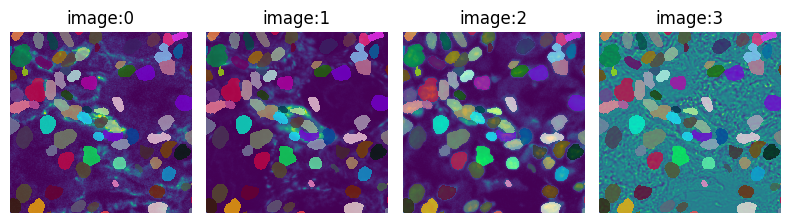

In [206]:
crop = image.crop_center(int(y), int(x), radius=200)
crop.show(layer='image', channelwise=True, segmentation_layer='segmented')
plt.savefig("figures/segmentation/segmasks_examples.pdf", dpi=600,bbox_inches='tight')

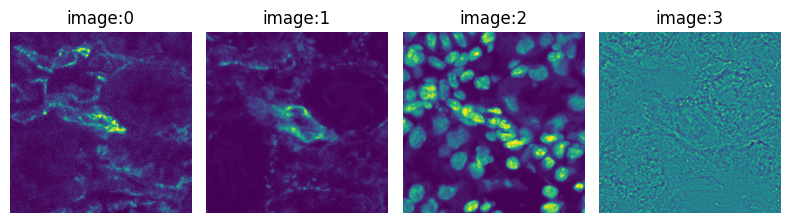

In [205]:
crop = image.crop_center(int(y), int(x), radius=200)
crop.show(layer='image', channelwise=True, 
         # segmentation_layer='segmented'
         )
#plt.savefig("figures/segmentation/segmasks_examples.pdf", dpi=600,bbox_inches='tight')

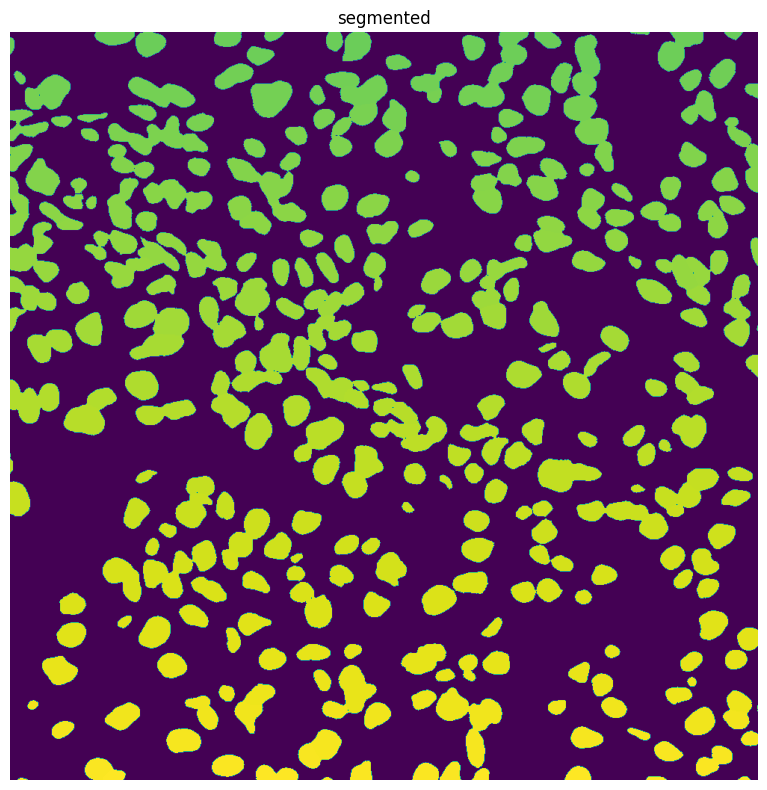

In [200]:
crop = image.crop_center(int(y), int(x), radius=500)
crop.show(layer='segmented')
#plt.savefig("figures/segmentation/segmasks_examples.pdf", dpi=600,bbox_inches='tight')

In [167]:
image = containers[key]

In [179]:
segimg = image['image'].sel(channels='dapi').to_numpy().squeeze()

segimg = db.im.resize_image(segimg.astype(np.uint8), scale_factor=0.2)

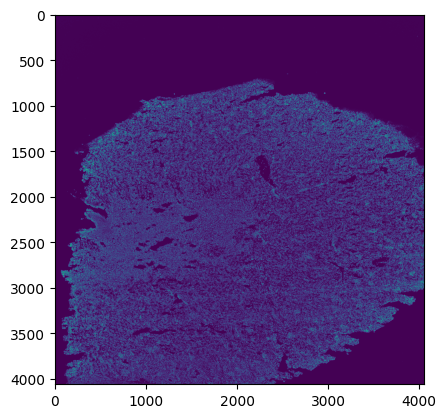

In [180]:
plt.imshow(segimg)

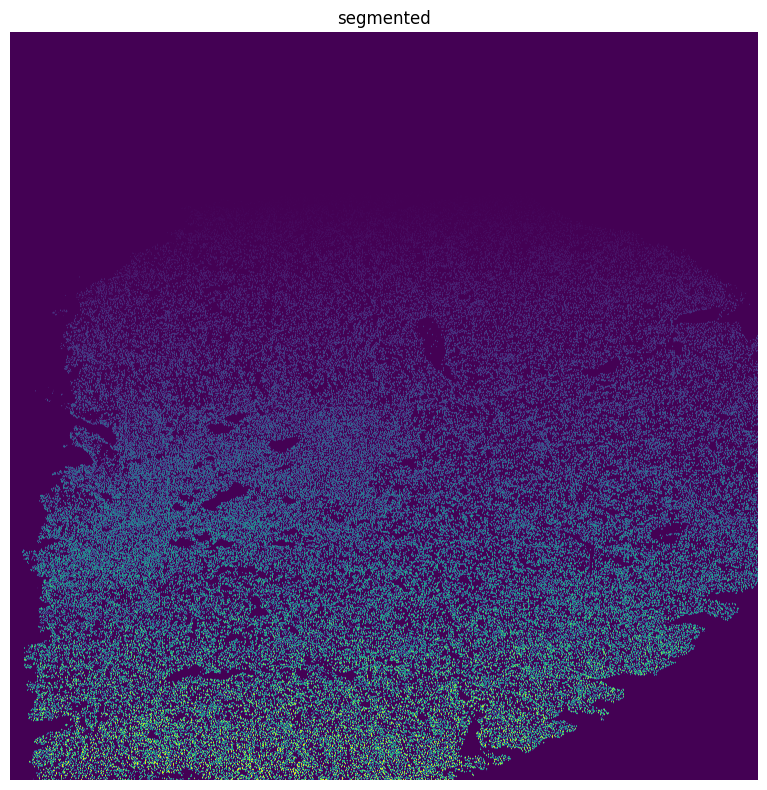

In [176]:
crop = image.crop_center()
image.show(layer='segmented')

In [136]:
regprops['37_46_C1']['intensity']['CD31']

,intensity_mean,intensity_max,intensity_min,image_intensity,proximity_signal,proximity_mask,signal_image,proximity_mean,proximity_median,proximity_sum,proximity_area,proximity_max,proximity_min
0,7.630841,51.0,0.0,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,...","[1, 19, 0, 1, 12, 5, 6, 2, 0, 15, 2, 7, 16, 1,...","[[False, False, False, False, False, False, Fa...","[[1, 1, 9, 1, 0, 1, 0, 1, 0, 0, 8, 0, 1, 0, 0,...",6.353169,3.0,26264,4134,60,0
1,10.108571,49.0,0.0,"[[0, 0, 0, 0, 0, 0, 0, 0, 15, 0, 0, 0, 0, 0, 0...","[8, 1, 2, 11, 45, 11, 1, 25, 8, 1, 4, 17, 9, 0...","[[False, False, False, False, False, False, Fa...","[[1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 15, 1, 0, 6...",7.981588,5.0,22109,2770,60,0
2,17.484076,63.0,0.0,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 15, 1...","[8, 0, 1, 0, 12, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0,...","[[False, False, False, False, False, False, Fa...","[[1, 0, 1, 0, 9, 1, 0, 1, 4, 1, 1, 0, 0, 1, 0,...",11.123596,7.0,38610,3471,106,0
3,9.178824,99.0,0.0,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 1,...","[5, 1, 5, 6, 13, 0, 11, 22, 3, 18, 0, 0, 20, 2...","[[False, False, False, False, False, False, Fa...","[[0, 1, 4, 13, 1, 3, 1, 1, 0, 1, 1, 1, 0, 1, 1...",9.164150,5.0,38242,4173,109,0
4,13.707155,58.0,0.0,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 25, 3, 0...","[1, 5, 2, 7, 4, 3, 6, 4, 1, 5, 6, 2, 4, 5, 9, ...","[[False, False, False, False, False, False, Fa...","[[0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 5, 1, 0, 1, 0,...",10.432613,7.0,39091,3747,106,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
101448,8.647799,28.0,0.0,"[[0, 0, 0, 0, 0, 0, 0, 0, 8, 6, 0, 0, 0, 0, 0,...","[7, 13, 32, 9, 12, 6, 4, 3, 26, 0, 2, 13, 10, ...","[[False, False, False, False, False, False, Fa...","[[7, 1, 3, 6, 4, 2, 9, 2, 0, 8, 0, 4, 0, 15, 4...",9.556202,9.0,14793,1548,38,0
101449,10.214815,27.0,0.0,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 0, 0,...","[23, 8, 12, 14, 20, 15, 13, 15, 19, 9, 26, 25,...","[[False, False, False, False, False, False, Fa...","[[8, 6, 3, 6, 9, 1, 13, 11, 8, 16, 10, 23, 4, ...",13.092617,12.0,19508,1490,50,0
101450,9.635417,28.0,0.0,"[[0, 0, 0, 0, 0, 0, 8, 6, 12, 20, 21, 0, 0, 0,...","[5, 11, 0, 26, 7, 3, 7, 4, 6, 8, 15, 16, 18, 0...","[[False, False, False, False, False, False, Fa...","[[4, 1, 7, 2, 6, 0, 10, 0, 1, 3, 1, 7, 0, 0, 0...",6.095133,5.0,8265,1356,39,0
101451,29.850877,125.0,4.0,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 17, 0, 0, 0...","[34, 21, 15, 27, 25, 28, 18, 16, 40, 41, 34, 4...","[[False, False, False, False, False, False, Fa...","[[27, 11, 12, 20, 4, 13, 14, 3, 8, 3, 6, 14, 4...",25.944215,23.0,37671,1452,99,0


In [162]:
regprops['37_46_C1']['binary']

,label,area,perimeter,eccentricity,centroid-0,centroid-1,bbox-0,bbox-1,bbox-2,bbox-3,vessel
0,1,856,108.325902,0.535701,3562.255841,11111.737150,3547,11094,3578,11130,False
1,2,175,50.284271,0.733373,3589.948571,11093.628571,3583,11086,3598,11103,False
2,3,471,83.112698,0.664572,3611.719745,10916.647558,3602,10902,3623,10931,False
3,4,850,107.982756,0.611576,3620.358824,11039.944706,3604,11023,3638,11057,False
4,5,601,92.083261,0.694571,3621.487521,10966.564060,3605,10955,3638,10979,False
...,...,...,...,...,...,...,...,...,...,...,...
101448,101449,159,56.142136,0.928408,20291.911950,9206.396226,20287,9195,20296,9219,False
101449,101450,135,52.142136,0.944336,20292.362963,7385.992593,20288,7375,20296,7398,False
101450,101451,96,41.313708,0.915307,20292.593750,5120.145833,20289,5112,20296,5130,False
101451,101452,114,50.763456,0.958076,20292.807018,8702.973684,20289,8692,20296,8715,False
